---

<h1 style="text-align: center;">MScAI Kaggle Competition 2022</h1>
<h3 style="text-align: center;">sUAV Image Segmentation</h3>

---

In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torchvision import transforms
from torch.utils.data.dataset import Dataset
from torch.utils.data import DataLoader

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import glob
from tqdm import tqdm
import time
import os

In [6]:
class config:
    BASE_PATH = "../input/msc-ai-2022/"
    TRAIN_IMG_PATH = BASE_PATH + "train_images/train_images"
    TRAIN_MASK_PATH = BASE_PATH + "train_masks/train_masks"
    TEST_IMG_PATH = BASE_PATH + "test_images/test_images"

# 1. Dataloaders

In [7]:
HEIGHT = 512
WIDTH = 512
BATCH_SIZE = 16

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Create a custom Dataset class
class tensorDataset(Dataset):
    def __init__(self, image_paths: list, mask_paths: list, train: bool, transform = None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.train = train
        self.transform = A.Compose([
            A.Resize(height=HEIGHT,width=WIDTH), # Resize the images to a specific size
            A.HorizontalFlip(p=0.5), # Randomly flip the images
            A.VerticalFlip(p=0.5), # Randomly flip the images
            A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.2), # Randomly change the brightness and contrast of the images
            A.OneOf([
                A.Blur(blur_limit=2, p=0.3),
                A.ColorJitter(p=0.3)
            ]),
            A.Normalize(
                mean=[0,0,0],
                std=[1,1,1],
                max_pixel_value=255),
            ToTensorV2()
        ])
        
        
       
    def __getitem__(self, index):
        
        # Select a specific image's path
        img_path  = self.image_paths[index]
        mask_path = self.mask_paths[index]
        
        # Load the image
        img = Image.open(img_path)
        mask = Image.open(mask_path)
        
        image = np.array(img)
        mask = np.array(mask)

        augmentations = self.transform(image=image, mask = mask)
        augmented_img = augmentations["image"]
        augmented_mask = augmentations["mask"]
        
        return augmented_img, augmented_mask

    def __len__(self):
        return len(self.image_paths)

In [12]:
# Very simple train/test split
train_ratio = 0.8
train_set_last_idx = int(len(glob.glob(config.TRAIN_IMG_PATH + "/*")) * train_ratio)

train_img_paths  = sorted(glob.glob(config.TRAIN_IMG_PATH + "/*"))[:train_set_last_idx]
train_mask_paths = sorted(glob.glob(config.TRAIN_MASK_PATH + "/*"))[:train_set_last_idx]
val_img_paths    = sorted(glob.glob(config.TRAIN_IMG_PATH + "/*"))[train_set_last_idx:]
val_mask_paths   = sorted(glob.glob(config.TRAIN_MASK_PATH + "/*"))[train_set_last_idx:]

# Create datasets
train_dataset = tensorDataset(train_img_paths, train_mask_paths, train=True)
val_dataset   = tensorDataset(val_img_paths, val_mask_paths, train=False)

# Create dataloaders
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2) #Increase the number of workers to be used on the CPU (i.e. here 2 is optimal according to our current system)
val_dataloader   = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2) #Increase the number of workers to be used on the CPU (i.e. here 2 is optimal according to our current system)

In [ ]:
# Test dataloaders
start = time.time()
for batch in tqdm(train_dataloader):
    img_batch, img_mask = batch

for batch in tqdm(val_dataloader):
    img_batch, img_mask = batch
      
end = time.time()
print(f'Seconds needed to load one train + val epoch: {end - start :.3f}')

The dataloaders are extremely slow! It takes around a minute to load one epoch, which can be a huge overhead if you want to train for e.g. 100 epochs. The reason is that the images are quite large (some around 3000x4000) and loading such images takes a lot of time. Ideally, for this dataset you should have dataloaders that load one epoch in a few seconds at max. To achieve this we can do a few things:

1. We could pre-process the images. Reszing the images beforehand to the desired height and width, will significantly decrease the loading time.
2. We could increase the number of workers. However, remember that the more batches you store at once, the less memory you have for other operations.

In [13]:
im, mask = next(iter(train_dataloader))

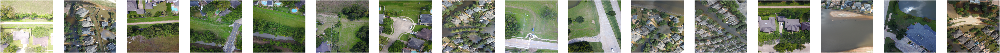

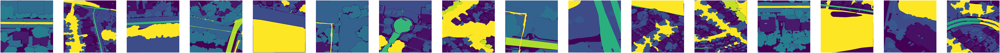

In [14]:
# Vizualize sat images
VIZUALIZE = "image"
fig, axes = plt.subplots(figsize = (256,256), ncols=BATCH_SIZE)
for ii in range(BATCH_SIZE):
    ax = axes[ii]
    if VIZUALIZE == "mask":
        ax.imshow((mask[ii]).unsqueeze(0).permute(1,2,0)) # Unnormalize and in range (0, 255) and permutation of PIL
    elif VIZUALIZE == "image":
        ax.imshow((im[ii]).permute(1, 2, 0))
    ax.axis('off')

# Vizualize corresponding masks
VIZUALIZE = "mask"
fig, axes = plt.subplots(figsize = (256,256), ncols=BATCH_SIZE)
for ii in range(BATCH_SIZE):
    ax = axes[ii]
    if VIZUALIZE == "mask":
        ax.imshow((mask[ii]).unsqueeze(0).permute(1,2,0)) # Unnormalize and in range (0, 255) and permutation of PIL
    elif VIZUALIZE == "image":
        ax.imshow((im[ii]).permute(1, 2, 0))
    ax.axis('off')
    

## 2. Model definition

### ResidualBlock
In order to be able to "dig" deeper in our UNet without 

In [15]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels,stride=1, downsample=None,dilation=1):
        super(ResidualBlock, self).__init__()
        """
        Residual block with identity mapping.
        """
        self.conv1 = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=stride, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.downsample = downsample

    def forward(self, x):
        #print("-------------- Residual Block --------------")
        
        residual = x
        #print(f"residual: {residual.shape}")
    
        out = self.conv1(x)
        #print(f"conv1: {out.shape}")
        out = self.bn1(out)
        #print(f"bn1: {out.shape}")
        out = self.relu(out)
        out = self.conv2(out)
        #print(f"conv2: {out.shape}")
        out = self.bn2(out)
        #print(f"bn1: {out.shape}")
        if self.downsample:
            residual = self.downsample(x)
            #print(f"downsampled: {residual.shape}")
        out += residual
        #print(f"out + residual: {out.shape}")
        out = self.relu(out)
        #print("-------------------------------------------")
        return out

### UNetResnet

In [16]:
class UNetResnet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        
        self.dilation = 1
        
        # ---------------- Encoder (Contracting Path) ---------------- #
        
        self.conv1 = nn.Conv2d(in_channels=in_channels, out_channels=64, kernel_size=3,stride=2, padding=1)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.conv1x1 = nn.Conv2d(3, 64, kernel_size=1,stride=2, padding=0)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.encoder1 = self.make_layer(block_type=ResidualBlock, in_channels=64,  out_channels=64, num_layers=3,stride=1)
        self.encoder2 = self.make_layer(block_type=ResidualBlock, in_channels=64,  out_channels=128, num_layers=4,stride=2)
        self.encoder3 = self.make_layer(block_type=ResidualBlock, in_channels=128,  out_channels=256, num_layers=6,stride=2)
        self.encoder4 = self.make_layer(block_type=ResidualBlock, in_channels=256,  out_channels=512, num_layers=3,stride=2)
        
        # ---------------- Create bottleneck ---------------- #
        self.bottleneck = nn.Conv2d(512, 512, 3, stride=1, padding='same')
        
        # ---------------- Decoder (Upsampling Path) ---------------- #
        
        self.convtrans1 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        #concatenate here
        self.decoder1 = self.make_layer(ResidualBlock, 512, 256, num_layers=1)
        
        self.convtrans2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        #concatenate here
        self.decoder2 = self.make_layer(ResidualBlock, 256, 128, num_layers=1)
        
        self.convtrans3 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        #concatenate here
        self.decoder3 = self.make_layer(ResidualBlock, 128, 64, num_layers=1)
        
        self.convtrans4 = nn.ConvTranspose2d(64, 64, kernel_size=2, stride=2)
        #concatenate here
        self.decoder4 = self.make_layer(ResidualBlock, 128, 64, num_layers=1)
        
        # Final output
        self.final = nn.ConvTranspose2d(64, out_channels, kernel_size=2, stride=2)

    def make_layer(self,block_type, in_channels, out_channels, num_layers, stride=1,dilate=False):
        downsample = None
        previous_dilation = self.dilation
        
        if dilate:
            self.dilation *= stride
            stride = 1
            
        if stride != 1 or in_channels != out_channels:
            downsample = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1,stride=stride),
                nn.BatchNorm2d(out_channels))
            
        layers = []
        
        layers.append(block_type(in_channels, out_channels, stride, downsample, dilation=previous_dilation))
        
        in_channels = out_channels
        
        for i in range(num_layers-1):
            layers.append(block_type(in_channels, out_channels, dilation=self.dilation))

        return nn.Sequential(*layers)
    

    def forward(self, inputs):
        #print("# ------- First Conv ------- #")
        x = self.conv1(inputs)                # (batch_size, 64, 256, 256)
        x = self.bn1(x)                       # (batch_size, 64, 256, 256)
        x = self.relu(x)                      # (batch_size, 64, 256, 256)
        
        s = self.conv1x1(inputs)              # (batch_size, 64, 256, 256)
        skip1 = x + s                         # (batch_size, 64, 256, 256)
        
        maxpool = self.maxpool(x)             # (batch_size, 64, 128, 128)
        #print(f"x.shape: {x.shape}, s.shape: {s.shape},skip1.shape: {skip1.shape},maxpool.shape :{maxpool.shape}")
        
        #print("# ------- Encoder ------- #")
        #print("# ------- encoder1 ------- #")
        skip2 = self.encoder1(maxpool)        # (batch_size, 64, 128, 128)
        
        #print("# ------- encoder2 ------- #")
        skip3 = self.encoder2(skip2)          # (batch_size, 128, 64, 64)
        
        #print("# ------- encoder3 ------- #") 
        skip4 = self.encoder3(skip3)         # (batch_size, 256, 32, 32)

        #print("# ------- encoder3 ------- #") 
        skip5 = self.encoder4(skip4)         # (batch_size, 512, 16, 16)
        
        #print("# ------- Bottleneck ------- #")
        bottleneck =  self.bottleneck(skip5) # (batch_size, 512, 16, 16)
        #print(f"bottlenneck.shape: {bottleneck.shape}")
        
        #print("# ------- Decoder ------- #")
        
        #print("# ------- decoder1 ------- #")
        convtrans1 = self.convtrans1(bottleneck) # (batch_size, 256, 32, 32)
        #print(f"convtrans1: {convtrans1.shape}")
        x = torch.cat([convtrans1, skip4], axis=1)  # (batch_size, 512, 32, 32)
        #print(f"torch.cat([convtrans1, skip4]: {x.shape}") 
        decoder1 = self.decoder1(x)                 # (batch_size, 256, 32, 32)
        #print(f"decoder1: {decoder1.shape}")
        
        #print("# ------- decoder2 ------- #")
        convtrans2 = self.convtrans2(decoder1) # (batch_size, 128, 64, 64)
        #print(f"convtrans2: {convtrans2.shape}")
        x = torch.cat([convtrans2, skip3], axis=1)  # (batch_size, 256, 64, 64)
        #print(f"torch.cat([convtrans2, skip3]: {x.shape}") 
        decoder2 = self.decoder2(x)                 # (batch_size, 128, 64, 64)
        #print(f"decoder2: {decoder2.shape}")
        
        #print("# ------- decoder3 ------- #")
        convtrans3 = self.convtrans3(decoder2) # (batch_size, 64, 128, 128)
        #print(f"convtrans3: {convtrans3.shape}")
        x = torch.cat([convtrans3, skip2], axis=1)  # (batch_size, 128, 128, 128)
        #print(f"torch.cat([convtrans3, skip2]: {x.shape}") 
        decoder3 = self.decoder3(x)                 # (batch_size, 64, 128, 128)
        #print(f"decoder1: {decoder3.shape}")
        
        #print("# ------- decoder4 ------- #")
        convtrans4 = self.convtrans4(decoder3) # (batch_size, 64, 256, 256)
        #print(f"convtrans4: {convtrans4.shape}")
        x = torch.cat([convtrans4, skip1], axis=1)  # (batch_size,128, 256, 256)
        #print(f"torch.cat([convtrans4, skip1]: {x.shape}") 
        decoder4 = self.decoder4(x)                 # (batch_size, 64, 256, 256])
        #print(f"decoder1: {decoder4.shape}")

        # ------- Output ------- #
        
        final = self.final(decoder4)             # (batch_size, 25, 512, 512)
        #print(f"final: {final.shape}")              
        return final
        

# 3. Loss functions

In [17]:
#PyTorch
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):
        
        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = F.sigmoid(inputs)       
        
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()                            
        dice_loss = 1 - (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        BCE = F.binary_cross_entropy(inputs, targets, reduction='mean')
        Dice_BCE = BCE + dice_loss
        
        return Dice_BCE

In [18]:
def dice_loss(logits, true, eps=1e-7):
    """Computes the Sørensen–Dice loss.
    Note that PyTorch optimizers minimize a loss. In this
    case, we would like to maximize the dice loss so we
    return the negated dice loss.
    Args:
        true: a tensor of shape [B, 1, H, W].
        logits: a tensor of shape [B, C, H, W]. Corresponds to
            the raw output or logits of the model.
        eps: added to the denominator for numerical stability.
    Returns:
        dice_loss: the Sørensen–Dice loss.
    """
    num_classes = logits.shape[1]
    if num_classes == 1:
        true_1_hot = torch.eye(num_classes + 1)[true.squeeze(1)]
        true_1_hot = true_1_hot.permute(0, 3, 1, 2).float()
        true_1_hot_f = true_1_hot[:, 0:1, :, :]
        true_1_hot_s = true_1_hot[:, 1:2, :, :]
        true_1_hot = torch.cat([true_1_hot_s, true_1_hot_f], dim=1)
        pos_prob = torch.sigmoid(logits)
        neg_prob = 1 - pos_prob
        probas = torch.cat([pos_prob, neg_prob], dim=1)
    else:
        true_1_hot = torch.eye(num_classes)[true.squeeze(1)]
        true_1_hot = true_1_hot.permute(0, 3, 1, 2).float()
        probas = F.softmax(logits, dim=1)
    true_1_hot = true_1_hot.type(logits.type())
    dims = (0,) + tuple(range(2, true.ndimension()))
    intersection = torch.sum(probas * true_1_hot, dims)
    cardinality = torch.sum(probas + true_1_hot, dims)
    dice_loss = (2. * intersection / (cardinality + eps)).mean()
    return (1 - dice_loss)

# 4. Helper Functions

In [19]:
class EarlyStopper:
    def __init__(self, patience=1, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.min_validation_loss = np.inf

    def early_stop(self, validation_loss):
        if validation_loss < self.min_validation_loss:
            self.min_validation_loss = validation_loss
            self.counter = 0
        elif validation_loss > (self.min_validation_loss + self.min_delta):
            self.counter += 1
            if self.counter >= self.patience:
                return True
        return False

In [20]:
# Saving the best model during the training 
class SaveBestModel:
    """
    Class to save the best model while training. If the current epoch's 
    validation loss is less than the previous least less, then save the
    model state.
    """
    def __init__(self, best_valid_loss=float('inf'),best_val_acc=float(0)):
        self.best_valid_loss = best_valid_loss
        self.best_val_acc = best_val_acc

    def __call__(self, current_val_acc,epoch, model, optimizer, criterion):
        if current_val_acc > self.best_val_acc:
            self.best_val_acc = current_val_acc
            print(f"\nBest validation accuracy: {self.best_val_acc}")
            print(f"\nSaving best model for epoch: {epoch}\n")
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': criterion,
                }, 'best_model.pth')

In [21]:
save_best_model = SaveBestModel()

# 5. Training loop

### Parameters

In [22]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model = UNetResnet(in_channels=3, out_channels=25).to(device)

In [23]:
epochs = 60
lr = 0.0001
weight_decay = 0.001
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
criterion = nn.CrossEntropyLoss().to(device)

### WandB

In [63]:
# Install wandb on the device (only needed once if you are in local)
!pip install wandb --quiet --root-user-action=ignore
import wandb

In [64]:
# Then connect to your W&B account
def wandb_connect():
    wandb_api_key_label = "wandb_api_key"
    wandb_api_key = "469648c2753f5a7b32e6bb62820075f539d388cb" # here use your API key from WandB interface

    wandb_conx = wandb.login(key = wandb_api_key)
    #print(f"Connected to Wandb online interface : {wandb_conx}")

wandb_connect()

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


In [65]:
#Wandb part
hyps = {"batch_size":BATCH_SIZE,
        "learning_rate":lr,
        "optimizer": 'Adam',
        "epochs":epochs,
        "criterion": 'CrossEntropyLoss',
        "model": 'UnetResnet',
        "num_workers": 2,
       }

In [66]:
wandb.init(project="kaggle-compet-mscai", entity="nicoboou", config=hyps)

epochs,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
train_acc,▁▃▄▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████
train_dice,▁▃▄▅▆▆▆▆▆▆▆▆▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇█████████████
train_loss,█▇▆▅▅▅▄▄▄▃▃▃▃▃▂▃▂▃▂▂▂▂▂▂▁▂▂▁▁▁▁▂▂▁▁▁▁▁▁▁
val_acc,▁▃▄▆▆▆▆▇▇▆▆▇▇▇▇▇▇▇▇▇█▇██████████████▇███
val_dice,▁▃▄▆▆▆▆▇▇▆▆▇▇▇▇▇▇▇▇▇█▇██████████████▇███
val_loss,█▇▅▅▄▄▃▃▃▃▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁
epochs,60
train_acc,0.8197
train_dice,0.8197
train_loss,0.62013


### Train

In [24]:
from torchmetrics import Dice
dice = Dice(average='micro').to(device)

#Parametrize early stopping
early_stopper = EarlyStopper(patience=3, min_delta=10)

def train(model, epochs, optimizer, criterion):
    
    for epoch in range(1,epochs+1):
        
        train_losses = []
        train_accuracy = []
        val_losses = []
        val_accuracy = []
        train_dice = []
        val_dice = []
        
        ## ------------------------- TRAINING ------------------------- ##
        model.train()
        for i, batch in enumerate(tqdm(train_dataloader)):
            # Extract images and masks
            img_batch, mask_batch = batch  # img [B,3,H,W], mask[B,H,W]
            img_batch, mask_batch = img_batch.to(device=device), mask_batch.long().to(device=device)
            
            # Optimize network
            optimizer.zero_grad()
            output = model(img_batch) # output: [B, 25, H, W]
            #loss = dice_loss(output, mask_batch)
            loss = criterion(output, mask_batch)
            wandb.log({"train_loss":loss.item()}) # log the training loss at each batch
            loss.backward()
            optimizer.step()
          
            # Save batch results
            train_losses.append(loss.item())
            preds = torch.argmax(output, dim=1)
            acc = torch.sum(preds == mask_batch).item() / (mask_batch.shape[0] * mask_batch.shape[1] * mask_batch.shape[2])
            
            dice_coeff = dice(preds, mask_batch)
            # we divide by (batch_size * height * width) to get average accuracy per pixel
            train_accuracy.append(acc)
            train_dice.append(dice_coeff.cpu())

        ## ------------------------- VALIDATION ------------------------- ##
    
        model.eval()
        best_val_loss = float('inf')
        best_val_acc = float(0)
        with torch.no_grad():
            
            for i, batch in enumerate(tqdm(val_dataloader)):
                #Extract data, labels
                img_batch, mask_batch = batch  # img [B,3,H,W], mask[B,H,W]
                img_batch, mask_batch = img_batch.to(device=device), mask_batch.long().to(device=device)

                #Validate model
                output = model(img_batch)
                #loss = dice_loss(output, mask_batch)
                loss = criterion(output, mask_batch)

                # Save batch results
                val_losses.append(loss.item())
                preds = torch.argmax(output, dim=1)
                acc = torch.sum(preds == mask_batch).item() / (mask_batch.shape[0] * mask_batch.shape[1] * mask_batch.shape[2])
                dice_coeff = dice(preds, mask_batch)
                val_accuracy.append(acc)
                val_dice.append(dice_coeff.cpu())
        
        train_acc = np.mean(train_accuracy)
        train_dice_mean = np.mean(train_dice)
        
        val_acc = np.mean(val_accuracy)
        val_dice_mean = np.mean(val_dice)
        
        val_loss_mean = np.mean(val_losses)
        wandb.log({"train_acc":train_acc, "val_acc":val_acc, "val_loss":val_loss_mean, "train_dice":train_dice_mean,"val_dice":val_dice_mean,"epochs":epoch}) # log the train & val accuracy and the val loss at each epoch
        ##### #print epoch results ######
        print(f'TRAIN       Epoch: {epoch} | Epoch metrics | loss: {np.mean(train_losses):.4f}, accuracy: {np.mean(train_accuracy):.3f},dice: {np.mean(train_dice):.3f}')        
        print(f'VALIDATION  Epoch: {epoch} | Epoch metrics | loss: {np.mean(val_losses):.4f}, accuracy: {np.mean(val_accuracy):.3f},,dice: {np.mean(val_dice):.3f}')
        print('-' * 70)
        save_best_model(val_acc, epoch, model, optimizer, criterion)
        if early_stopper.early_stop(val_loss_mean):
            break

In [68]:
torch.cuda.empty_cache()

In [69]:
train(model, epochs, optimizer, criterion)

100%|██████████| 4/4 [00:15<00:00,  3.94s/it]


TRAIN       Epoch: 1 | Epoch metrics | loss: 3.1043, accuracy: 0.143,dice: 0.143
VALIDATION  Epoch: 1 | Epoch metrics | loss: 3.1715, accuracy: 0.055,,dice: 0.055
----------------------------------------------------------------------

Best validation accuracy: 0.05544617176055908

Saving best model for epoch: 1



100%|██████████| 4/4 [00:15<00:00,  3.90s/it]


TRAIN       Epoch: 2 | Epoch metrics | loss: 2.7951, accuracy: 0.312,dice: 0.312
VALIDATION  Epoch: 2 | Epoch metrics | loss: 3.1174, accuracy: 0.113,,dice: 0.113
----------------------------------------------------------------------

Best validation accuracy: 0.11260510683059692

Saving best model for epoch: 2



100%|██████████| 4/4 [00:15<00:00,  3.78s/it]


TRAIN       Epoch: 3 | Epoch metrics | loss: 2.5778, accuracy: 0.423,dice: 0.423
VALIDATION  Epoch: 3 | Epoch metrics | loss: 2.6580, accuracy: 0.325,,dice: 0.325
----------------------------------------------------------------------

Best validation accuracy: 0.32466964721679686

Saving best model for epoch: 3



100%|██████████| 4/4 [00:16<00:00,  4.07s/it]


TRAIN       Epoch: 4 | Epoch metrics | loss: 2.3952, accuracy: 0.510,dice: 0.510
VALIDATION  Epoch: 4 | Epoch metrics | loss: 2.3750, accuracy: 0.434,,dice: 0.434
----------------------------------------------------------------------

Best validation accuracy: 0.4335524678230286

Saving best model for epoch: 4



100%|██████████| 4/4 [00:15<00:00,  3.88s/it]


TRAIN       Epoch: 5 | Epoch metrics | loss: 2.2312, accuracy: 0.569,dice: 0.569
VALIDATION  Epoch: 5 | Epoch metrics | loss: 2.1988, accuracy: 0.534,,dice: 0.534
----------------------------------------------------------------------

Best validation accuracy: 0.5342000126838684

Saving best model for epoch: 5



100%|██████████| 4/4 [00:14<00:00,  3.74s/it]


TRAIN       Epoch: 6 | Epoch metrics | loss: 2.1076, accuracy: 0.604,dice: 0.604
VALIDATION  Epoch: 6 | Epoch metrics | loss: 2.0917, accuracy: 0.566,,dice: 0.566
----------------------------------------------------------------------

Best validation accuracy: 0.5660937666893006

Saving best model for epoch: 6



100%|██████████| 4/4 [00:15<00:00,  3.88s/it]


TRAIN       Epoch: 7 | Epoch metrics | loss: 1.9779, accuracy: 0.630,dice: 0.630
VALIDATION  Epoch: 7 | Epoch metrics | loss: 1.9138, accuracy: 0.603,,dice: 0.603
----------------------------------------------------------------------

Best validation accuracy: 0.6026249647140502

Saving best model for epoch: 7



100%|██████████| 4/4 [00:15<00:00,  3.77s/it]


TRAIN       Epoch: 8 | Epoch metrics | loss: 1.8706, accuracy: 0.647,dice: 0.647
VALIDATION  Epoch: 8 | Epoch metrics | loss: 1.9127, accuracy: 0.598,,dice: 0.598
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.81s/it]


TRAIN       Epoch: 9 | Epoch metrics | loss: 1.7667, accuracy: 0.662,dice: 0.662
VALIDATION  Epoch: 9 | Epoch metrics | loss: 1.7889, accuracy: 0.605,,dice: 0.605
----------------------------------------------------------------------

Best validation accuracy: 0.605107581615448

Saving best model for epoch: 9



100%|██████████| 4/4 [00:15<00:00,  3.96s/it]


TRAIN       Epoch: 10 | Epoch metrics | loss: 1.6873, accuracy: 0.667,dice: 0.667
VALIDATION  Epoch: 10 | Epoch metrics | loss: 1.7732, accuracy: 0.611,,dice: 0.611
----------------------------------------------------------------------

Best validation accuracy: 0.6106158137321472

Saving best model for epoch: 10



100%|██████████| 4/4 [00:15<00:00,  3.80s/it]


TRAIN       Epoch: 11 | Epoch metrics | loss: 1.5999, accuracy: 0.680,dice: 0.680
VALIDATION  Epoch: 11 | Epoch metrics | loss: 1.7242, accuracy: 0.603,,dice: 0.603
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.95s/it]


TRAIN       Epoch: 12 | Epoch metrics | loss: 1.5428, accuracy: 0.686,dice: 0.686
VALIDATION  Epoch: 12 | Epoch metrics | loss: 1.6446, accuracy: 0.634,,dice: 0.634
----------------------------------------------------------------------

Best validation accuracy: 0.6341386675834656

Saving best model for epoch: 12



100%|██████████| 4/4 [00:14<00:00,  3.73s/it]


TRAIN       Epoch: 13 | Epoch metrics | loss: 1.4684, accuracy: 0.693,dice: 0.693
VALIDATION  Epoch: 13 | Epoch metrics | loss: 1.5747, accuracy: 0.633,,dice: 0.633
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.89s/it]


TRAIN       Epoch: 14 | Epoch metrics | loss: 1.3997, accuracy: 0.704,dice: 0.704
VALIDATION  Epoch: 14 | Epoch metrics | loss: 1.5567, accuracy: 0.631,,dice: 0.631
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.86s/it]


TRAIN       Epoch: 15 | Epoch metrics | loss: 1.3478, accuracy: 0.710,dice: 0.710
VALIDATION  Epoch: 15 | Epoch metrics | loss: 1.5050, accuracy: 0.641,,dice: 0.641
----------------------------------------------------------------------

Best validation accuracy: 0.6409070372581482

Saving best model for epoch: 15



100%|██████████| 4/4 [00:14<00:00,  3.71s/it]


TRAIN       Epoch: 16 | Epoch metrics | loss: 1.3118, accuracy: 0.711,dice: 0.711
VALIDATION  Epoch: 16 | Epoch metrics | loss: 1.4449, accuracy: 0.638,,dice: 0.638
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.90s/it]


TRAIN       Epoch: 17 | Epoch metrics | loss: 1.2614, accuracy: 0.719,dice: 0.719
VALIDATION  Epoch: 17 | Epoch metrics | loss: 1.4058, accuracy: 0.643,,dice: 0.643
----------------------------------------------------------------------

Best validation accuracy: 0.6434726595878602

Saving best model for epoch: 17



100%|██████████| 4/4 [00:15<00:00,  3.80s/it]


TRAIN       Epoch: 18 | Epoch metrics | loss: 1.2288, accuracy: 0.715,dice: 0.715
VALIDATION  Epoch: 18 | Epoch metrics | loss: 1.3415, accuracy: 0.652,,dice: 0.652
----------------------------------------------------------------------

Best validation accuracy: 0.651692247390747

Saving best model for epoch: 18



100%|██████████| 4/4 [00:15<00:00,  3.88s/it]


TRAIN       Epoch: 19 | Epoch metrics | loss: 1.2037, accuracy: 0.716,dice: 0.716
VALIDATION  Epoch: 19 | Epoch metrics | loss: 1.2816, accuracy: 0.673,,dice: 0.673
----------------------------------------------------------------------

Best validation accuracy: 0.6727071046829224

Saving best model for epoch: 19



100%|██████████| 4/4 [00:15<00:00,  3.92s/it]


TRAIN       Epoch: 20 | Epoch metrics | loss: 1.1923, accuracy: 0.715,dice: 0.715
VALIDATION  Epoch: 20 | Epoch metrics | loss: 1.3761, accuracy: 0.644,,dice: 0.644
----------------------------------------------------------------------


100%|██████████| 4/4 [00:14<00:00,  3.73s/it]


TRAIN       Epoch: 21 | Epoch metrics | loss: 1.1290, accuracy: 0.734,dice: 0.734
VALIDATION  Epoch: 21 | Epoch metrics | loss: 1.2693, accuracy: 0.661,,dice: 0.661
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.91s/it]


TRAIN       Epoch: 22 | Epoch metrics | loss: 1.1167, accuracy: 0.731,dice: 0.731
VALIDATION  Epoch: 22 | Epoch metrics | loss: 1.2814, accuracy: 0.657,,dice: 0.657
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.76s/it]


TRAIN       Epoch: 23 | Epoch metrics | loss: 1.1134, accuracy: 0.722,dice: 0.722
VALIDATION  Epoch: 23 | Epoch metrics | loss: 1.2515, accuracy: 0.653,,dice: 0.653
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.79s/it]


TRAIN       Epoch: 24 | Epoch metrics | loss: 1.0757, accuracy: 0.732,dice: 0.732
VALIDATION  Epoch: 24 | Epoch metrics | loss: 1.1535, accuracy: 0.680,,dice: 0.680
----------------------------------------------------------------------

Best validation accuracy: 0.6800442218780518

Saving best model for epoch: 24



100%|██████████| 4/4 [00:15<00:00,  3.97s/it]


TRAIN       Epoch: 25 | Epoch metrics | loss: 1.0310, accuracy: 0.740,dice: 0.740
VALIDATION  Epoch: 25 | Epoch metrics | loss: 1.1896, accuracy: 0.661,,dice: 0.661
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.80s/it]


TRAIN       Epoch: 26 | Epoch metrics | loss: 1.0326, accuracy: 0.734,dice: 0.734
VALIDATION  Epoch: 26 | Epoch metrics | loss: 1.1363, accuracy: 0.683,,dice: 0.683
----------------------------------------------------------------------

Best validation accuracy: 0.6834818005561829

Saving best model for epoch: 26



100%|██████████| 4/4 [00:16<00:00,  4.12s/it]


TRAIN       Epoch: 27 | Epoch metrics | loss: 0.9977, accuracy: 0.747,dice: 0.747
VALIDATION  Epoch: 27 | Epoch metrics | loss: 1.1209, accuracy: 0.674,,dice: 0.674
----------------------------------------------------------------------


100%|██████████| 4/4 [00:14<00:00,  3.71s/it]


TRAIN       Epoch: 28 | Epoch metrics | loss: 0.9768, accuracy: 0.749,dice: 0.749
VALIDATION  Epoch: 28 | Epoch metrics | loss: 1.1467, accuracy: 0.679,,dice: 0.679
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.82s/it]


TRAIN       Epoch: 29 | Epoch metrics | loss: 0.9516, accuracy: 0.755,dice: 0.755
VALIDATION  Epoch: 29 | Epoch metrics | loss: 1.1715, accuracy: 0.656,,dice: 0.656
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.91s/it]


TRAIN       Epoch: 30 | Epoch metrics | loss: 0.9376, accuracy: 0.753,dice: 0.753
VALIDATION  Epoch: 30 | Epoch metrics | loss: 1.1340, accuracy: 0.673,,dice: 0.673
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.77s/it]


TRAIN       Epoch: 31 | Epoch metrics | loss: 0.9199, accuracy: 0.756,dice: 0.756
VALIDATION  Epoch: 31 | Epoch metrics | loss: 1.1017, accuracy: 0.679,,dice: 0.679
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.93s/it]


TRAIN       Epoch: 32 | Epoch metrics | loss: 0.9390, accuracy: 0.744,dice: 0.744
VALIDATION  Epoch: 32 | Epoch metrics | loss: 1.0896, accuracy: 0.679,,dice: 0.679
----------------------------------------------------------------------


100%|██████████| 4/4 [00:15<00:00,  3.75s/it]


TRAIN       Epoch: 33 | Epoch metrics | loss: 0.9217, accuracy: 0.748,dice: 0.748
VALIDATION  Epoch: 33 | Epoch metrics | loss: 1.0530, accuracy: 0.687,,dice: 0.687
----------------------------------------------------------------------

Best validation accuracy: 0.6869131088256836

Saving best model for epoch: 33



  0%|          | 0/13 [00:03<?, ?it/s]


KeyboardInterrupt: 

# 4. Error Analysis

In [28]:
# Transfer model from gpu to cpu
#model.load_state_dict(torch.load('/kaggle/input/models/UNetResnet-Adam-CrossEntr-lr0.0001-50epc-512px-bs8.pt')) 
model.load_state_dict(torch.load('/kaggle/input/best-models/best_model(2).pth')['model_state_dict']) 
model = model.cpu()

In [29]:
def visualise_model_performance(model: nn.Module, idx: int):
    
    # Load image
    img_paths = sorted(glob.glob(config.TRAIN_IMG_PATH + "/*"))
    mask_paths = sorted(glob.glob(config.TRAIN_MASK_PATH + "/*"))
    img_path = img_paths[idx]
    mask_path = mask_paths[idx]
    img = Image.open(img_path)
    true_mask = Image.open(mask_path)
    
    # Resize to the same shape as used in training
    resize_mask = transforms.Compose([
            transforms.Resize([HEIGHT,WIDTH], interpolation = transforms.InterpolationMode.NEAREST), # Important
            transforms.ToTensor()
        ])
    
    resize_img = transforms.Compose([
            transforms.Resize([HEIGHT,WIDTH]),
            transforms.ToTensor()
        ])
    img = resize_img(img)
    true_mask = resize_mask(true_mask)
    
    # Model accepts batches of images, not single images so we need to reshape tensors
    # From [C, H, W] to [B, C, H, W]
    img = img.unsqueeze(0)
    
    # Get predictions
    output = model(img)
    preds = torch.argmax(output, dim=1)
    
    # Tranform to numpy and reshape for plotting
    img = img.squeeze().permute(1,2,0).detach().numpy()
    preds = preds.permute(1,2,0).detach().numpy()
    true_mask = true_mask.permute(1,2,0).detach().numpy()
    
    # Plot
    f, axarr = plt.subplots(1,3, figsize=(15,5))
    axarr[0].imshow(img)
    axarr[1].imshow(preds, cmap='tab20')
    axarr[2].imshow(true_mask, cmap='tab20')
    axarr[0].set_title('Image')
    axarr[1].set_title('Model prediction')
    axarr[2].set_title('True mask')
    for ax in axarr:
        ax.set_xticks([])
        ax.set_yticks([])
    plt.show()

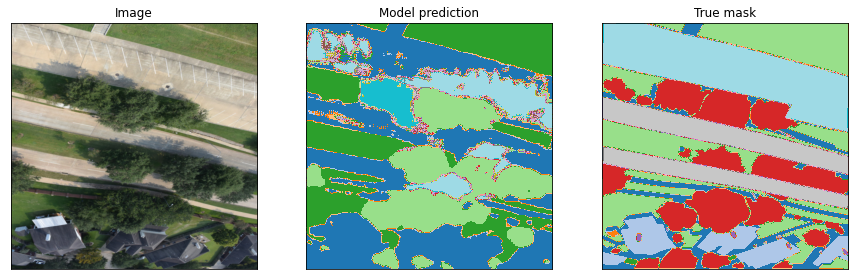

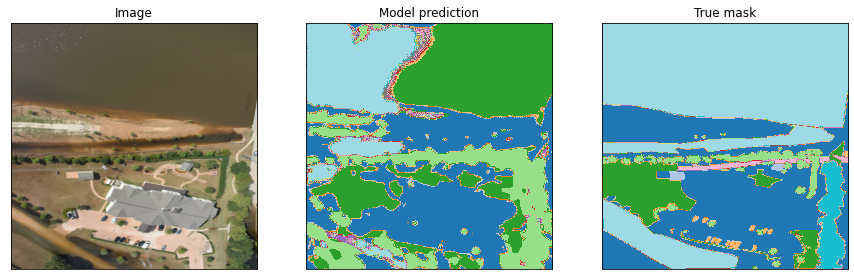

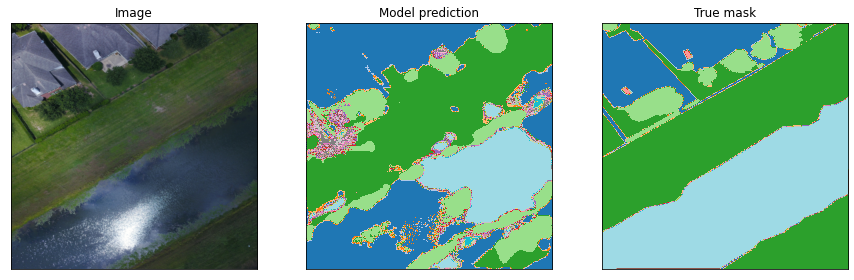

In [30]:
visualise_model_performance(model, 45)
visualise_model_performance(model, 55)
visualise_model_performance(model, 200)

# 5. Submission

In [31]:
!mkdir /kaggle/working/test_predictions

In [34]:
# Load and transform test images
resize_img = transforms.Compose([
            transforms.Resize([HEIGHT,WIDTH]),
            transforms.ToTensor()
        ])
test_img_link_list = sorted(glob.glob(config.TEST_IMG_PATH + '/*'))
torch_list = [resize_img(Image.open(link)) for link in test_img_link_list]

In [35]:
model.eval()

# calculate output for each image in test set and save the prediction in new folder
for i in tqdm(range(len(torch_list))):
    img_id = test_img_link_list[i].split('/')[-1].split('.')[0]
    img = torch_list[i].unsqueeze(0)
    output = model(img)
    output = torch.argmax(output, dim=1).squeeze(0)
    output = np.uint8(output)
    output = Image.fromarray(output)
    output.save(f"/kaggle/working/test_predictions/{img_id}.png")

100%|██████████| 112/112 [01:47<00:00,  1.04it/s]


In [36]:
%cd /kaggle/working

/kaggle/working


In [37]:
def rle_encode(img):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

def rle_decode(mask_rle, shape):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (height,width) of array to return
    Returns numpy array, 1 - mask, 0 - background
    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape)


def create_rles():
    """Used for Kaggle submission: predicts and encode all test images"""
    dir = '/kaggle/working/test_predictions/'  # CHANGE DIRECTORY IF NEEDED
    N = len(list(os.listdir(dir)))
    with open('submission_file_best_4.csv', 'w') as f:
        f.write('ImageClassId,rle_mask\n')
        for index, i in enumerate(os.listdir(dir)):
            # #print('{}/{}'.format(index, N))
                
            #print(i)
            if i[0] != '.':
                mask = Image.open(dir + i)
                mask = mask.resize((1024, 1024), resample=Image.NEAREST)
                mask = np.array(mask)

                for x in range(1, 25):
                    enc = rle_encode(mask == x)
                    f.write(f"{i.split('_')[0]}_{x},{enc}\n")

create_rles()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:40: DeprecationWarning: NEAREST is deprecated and will be removed in Pillow 10 (2023-07-01). Use Resampling.NEAREST or Dither.NONE instead.
